<!DOCTYPE html>
<html>
<body>
<div align="center">
<h3>Made by Manthan A Panchal</h3>
    
<h1>SVM - Classification </h1>

<h3>Follow Me on - <a href="https://www.linkedin.com/in/manthan-panchal-046b3b198/">LinkedIn</a>&nbsp; 
</div>

</div>
</body>
</html>

### Problem Statement

1) Prepare a classification model using SVM for salary data 

Data Description:

age -- age of a person
workclass	-- A work class is a grouping of work 
education	-- Education of an individuals	
maritalstatus -- Marital status of an individulas	
occupation	 -- occupation of an individuals
relationship -- 	
race --  Race of an Individual
sex --  Gender of an Individual
capitalgain --  profit received from the sale of an investment	
capitalloss	-- A decrease in the value of a capital asset
hoursperweek -- number of hours work per week	
native -- Native of an individual
Salary -- salary of an individual


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import svm
from sklearn.svm import SVC

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler, OneHotEncoder, StandardScaler, MinMaxScaler, OrdinalEncoder, LabelEncoder
from sklearn.metrics import confusion_matrix

from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, confusion_matrix

pd.set_option('display.max_rows', None)
plt.style.use('seaborn-darkgrid')

In [2]:
df = pd.read_csv('SalaryData_Train.csv')
df

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
5,37,Private,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K
6,49,Private,9th,5,Married-spouse-absent,Other-service,Not-in-family,Black,Female,0,0,16,Jamaica,<=50K
7,52,Self-emp-not-inc,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,>50K
8,31,Private,Masters,14,Never-married,Prof-specialty,Not-in-family,White,Female,14084,0,50,United-States,>50K
9,42,Private,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,5178,0,40,United-States,>50K


In [3]:
df.shape

(30161, 14)

In [4]:
df.Salary.value_counts()

 <=50K    22653
 >50K      7508
Name: Salary, dtype: int64

In [5]:
df.workclass.value_counts()

 Private             22285
 Self-emp-not-inc     2499
 Local-gov            2067
 State-gov            1279
 Self-emp-inc         1074
 Federal-gov           943
 Without-pay            14
Name: workclass, dtype: int64

In [6]:
df.groupby(['educationno']).count()

,age,workclass,education,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
educationno,,,,,,,,,,,,,
1,45,45,45,45,45,45,45,45,45,45,45,45,45
2,151,151,151,151,151,151,151,151,151,151,151,151,151
3,288,288,288,288,288,288,288,288,288,288,288,288,288
4,557,557,557,557,557,557,557,557,557,557,557,557,557
5,455,455,455,455,455,455,455,455,455,455,455,455,455
6,820,820,820,820,820,820,820,820,820,820,820,820,820
7,1048,1048,1048,1048,1048,1048,1048,1048,1048,1048,1048,1048,1048
8,377,377,377,377,377,377,377,377,377,377,377,377,377
9,9840,9840,9840,9840,9840,9840,9840,9840,9840,9840,9840,9840,9840


### the columns eductaion is of no use so we can drop it

In [7]:
df = df.drop(['education'], axis=1)

In [8]:
df.head()

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [9]:
df.native.value_counts()

 United-States                 27504
 Mexico                          610
 Philippines                     188
 Germany                         128
 Puerto-Rico                     109
 Canada                          107
 India                           100
 El-Salvador                     100
 Cuba                             92
 England                          86
 Jamaica                          80
 South                            71
 China                            68
 Italy                            68
 Dominican-Republic               67
 Vietnam                          64
 Guatemala                        63
 Japan                            59
 Columbia                         56
 Poland                           56
 Iran                             42
 Taiwan                           42
 Haiti                            42
 Portugal                         34
 Nicaragua                        33
 Peru                             30
 Greece                           29
 

As we can see above the columns native is a nominal categorical data so we cannot use label encoder and ordinal encode we will have to use one hot encoding 
but using it will add another 40 columns which will make it computationally expensive and the information gain for it columns is not significant enough for the computationallyional expense.

In [10]:
df = df.drop(['native'], axis=1)
df.head()

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,Salary
0,39,State-gov,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,<=50K
1,50,Self-emp-not-inc,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,<=50K
2,38,Private,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,<=50K
3,53,Private,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,<=50K
4,28,Private,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,<=50K


In [11]:
df.workclass.unique()

array([' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' Self-emp-inc', ' Without-pay'], dtype=object)

In [12]:
df.relationship.unique()

array([' Not-in-family', ' Husband', ' Wife', ' Own-child', ' Unmarried',
       ' Other-relative'], dtype=object)

In [13]:
df.race.unique()

array([' White', ' Black', ' Asian-Pac-Islander', ' Amer-Indian-Eskimo',
       ' Other'], dtype=object)

In [14]:
df.occupation.unique()

array([' Adm-clerical', ' Exec-managerial', ' Handlers-cleaners',
       ' Prof-specialty', ' Other-service', ' Sales', ' Transport-moving',
       ' Farming-fishing', ' Machine-op-inspct', ' Tech-support',
       ' Craft-repair', ' Protective-serv', ' Armed-Forces',
       ' Priv-house-serv'], dtype=object)

In [15]:
df.maritalstatus.unique()

array([' Never-married', ' Married-civ-spouse', ' Divorced',
       ' Married-spouse-absent', ' Separated', ' Married-AF-spouse',
       ' Widowed'], dtype=object)

In [16]:
sal = [' <=50K', ' >=50K']
sex = [' Male', ' Female']
race = [' White', ' Black', ' Asian-Pac-Islander', ' Amer-Indian-Eskimo', ' Other']
relation = [' Not-in-family', ' Unmarried',' Husband',' Own-child',' Wife', ' Other-relative' ]
occupation = [ ' Adm-clerical', ' Exec-managerial', ' Handlers-cleaners',
       ' Prof-specialty', ' Other-service', ' Sales', ' Transport-moving',
       ' Farming-fishing', ' Machine-op-inspct', ' Tech-support',
       ' Craft-repair', ' Protective-serv', ' Armed-Forces',
       ' Priv-house-serv']
marital  = [' Never-married', ' Married-civ-spouse', ' Divorced',
       ' Married-spouse-absent', ' Separated', ' Married-AF-spouse',
       ' Widowed']
workclass = [' State-gov', ' Self-emp-not-inc', ' Private', ' Federal-gov',
       ' Local-gov', ' Self-emp-inc', ' Without-pay']

In [17]:
X_train, X_test, y_train, y_test = train_test_split(
    df.drop(['Salary'], axis=1), 
    df.Salary, test_size=0.30, 
    random_state = 2)

In [18]:
num_cols = [cols for cols in df.columns if df[cols].dtype != 'O']
num_cols.remove('educationno')
num_cols

['age', 'capitalgain', 'capitalloss', 'hoursperweek']

In [19]:
cat_cols = [cols for cols in df.columns if df[cols].dtype == 'O']
cat_cols.remove('Salary')
cat_cols

['workclass', 'maritalstatus', 'occupation', 'relationship', 'race', 'sex']

In [20]:
encodercategory = [workclass, marital, occupation, relation, race, sex]

In [21]:
CT = ColumnTransformer([
    
    ('FeatureScaling', MinMaxScaler(), num_cols),
    ('FeatureEncoding', OrdinalEncoder(categories = encodercategory), cat_cols),
     
], remainder = 'drop')

In [39]:
pipe = Pipeline([
    
    ('ColumnTransformer', CT),
    
    ('Model', SVC(C= 15, gamma= 50, kernel='rbf'))
    
])

In [40]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('ColumnTransformer',
                 ColumnTransformer(transformers=[('FeatureScaling',
                                                  MinMaxScaler(),
                                                  ['age', 'capitalgain',
                                                   'capitalloss',
                                                   'hoursperweek']),
                                                 ('FeatureEncoding',
                                                  OrdinalEncoder(categories=[[' '
                                                                              'State-gov',
                                                                              ' '
                                                                              'Self-emp-not-inc',
                                                                              ' '
                                                                              'Private',
                           

In [41]:
pipe.score(X_test, y_test)

0.8089291634434744

In [42]:
y_pred = pipe.predict(X_test)

In [43]:
cm = confusion_matrix(y_test, y_pred)
cm

array([[6103,  679],
       [1050, 1217]], dtype=int64)

Text(102.58333333333333, 0.5, 'Predicted Values')

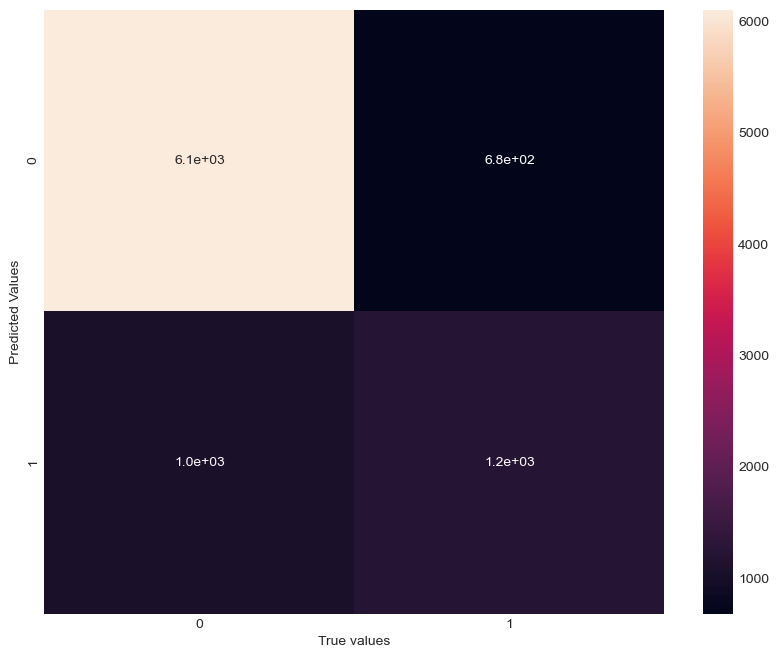

In [44]:
plt.figure(figsize=(10,8), dpi = 100)
sns.heatmap(cm, annot=True)
plt.xlabel('True values')
plt.ylabel('Predicted Values')